In [1]:
# pip install tensorflow

In [2]:
# pip install opencv-python

In [3]:
import tensorflow as tf
import matplotlib.pyplot as plt
import cv2
import os
import numpy as np

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.optimizers import RMSprop

In [4]:
img=image.load_img(r'D:\ANURAG GUPTA\MastitisDataForMurrah\Clinical_Normal_Murrah\train\clinical mastitis\IR_41661.jpg')

In [5]:
img.show()

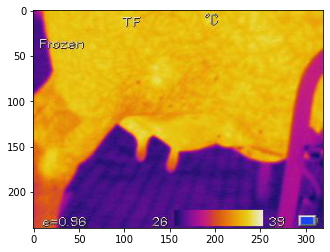

In [6]:
plt.imshow(img)

In [7]:
cv2.imread(r'D:\ANURAG GUPTA\MastitisDataForMurrah\Clinical_Normal_Murrah\train\clinical mastitis\IR_41661.jpg')

array([[[177,  94, 192],
        [146,  44, 152],
        [152,   7, 136],
        ...,
        [ 12, 189, 226],
        [ 12, 188, 228],
        [ 11, 187, 227]],

       [[129,  39, 138],
        [127,  21, 128],
        [151,   6, 135],
        ...,
        [ 14, 191, 228],
        [ 13, 189, 229],
        [ 13, 189, 229]],

       [[111,  12, 110],
        [134,  20, 127],
        [165,  19, 145],
        ...,
        [ 16, 192, 232],
        [ 16, 192, 233],
        [ 16, 192, 233]],

       ...,

       [[ 59,  66, 207],
        [ 58,  67, 208],
        [ 56,  67, 211],
        ...,
        [134,  22,  62],
        [121,  12,  51],
        [131,  24,  63]],

       [[ 62,  65, 204],
        [ 61,  65, 207],
        [ 57,  67, 209],
        ...,
        [131,  19,  59],
        [130,  15,  58],
        [137,  22,  65]],

       [[ 62,  63, 203],
        [ 60,  65, 204],
        [ 58,  66, 209],
        ...,
        [129,  17,  57],
        [131,  14,  59],
        [134,  17,  62]]

In [8]:
cv2.imread(r'D:\ANURAG GUPTA\MastitisDataForMurrah\Clinical_Normal_Murrah\train\clinical mastitis\IR_41661.jpg').shape

(240, 320, 3)

In [9]:
train=ImageDataGenerator(rescale=1/255)
validation=ImageDataGenerator(rescale=1/255)

In [10]:
train_dataset=train.flow_from_directory(r'D:\ANURAG GUPTA\MastitisDataForMurrah\Clinical_Normal_Murrah\train',
                                      target_size=(224,224),
                                      batch_size=100,
                                      class_mode='binary')

validation_dataset=validation.flow_from_directory(r'D:\ANURAG GUPTA\MastitisDataForMurrah\Clinical_Normal_Murrah\val',
                                      target_size=(224,224),
                                      batch_size=20,
                                      class_mode='binary')

Found 3406 images belonging to 2 classes.
Found 972 images belonging to 2 classes.


In [11]:
train_dataset.class_indices

{'clinical mastitis': 0, 'healthy': 1}

In [12]:
train_dataset.classes

array([0, 0, 0, ..., 1, 1, 1])

In [13]:
model=tf.keras.models.Sequential([tf.keras.layers.Conv2D(16,(3,3),activation='relu',input_shape=(224,224,3)),
                                 tf.keras.layers.MaxPool2D(2,2),
                                  #
                                  tf.keras.layers.Conv2D(32,(3,3),activation='relu'),
                                  tf.keras.layers.MaxPool2D(2,2),
                                  #
                                  tf.keras.layers.Conv2D(64,(3,3),activation='relu'),
                                  tf.keras.layers.MaxPool2D(2,2),
                                  ##
                                  tf.keras.layers.Flatten(),
                                  ##
                                  tf.keras.layers.Dense(512,activation='relu'),
                                  ##
                                  tf.keras.layers.Dense(1,activation='sigmoid')
                                  ])

In [14]:
model.compile(loss='binary_crossentropy',
             optimizer= RMSprop(learning_rate=0.001),
             metrics=['accuracy'])

In [15]:
model_fit = model.fit(train_dataset,
                   steps_per_epoch = 10,
                   epochs= 25,
                   validation_data= validation_dataset)

Epoch 1/25
10/10 [==============================] - 28s 3s/step - loss: 1.8583 - accuracy: 0.5170 - val_loss: 0.6023 - val_accuracy: 0.6986
Epoch 2/25
10/10 [==============================] - 23s 2s/step - loss: 0.6053 - accuracy: 0.6870 - val_loss: 0.5273 - val_accuracy: 0.7171
Epoch 3/25
10/10 [==============================] - 21s 2s/step - loss: 0.5764 - accuracy: 0.7000 - val_loss: 0.6802 - val_accuracy: 0.6111
Epoch 4/25
10/10 [==============================] - 21s 2s/step - loss: 0.5426 - accuracy: 0.7320 - val_loss: 0.4665 - val_accuracy: 0.7510
Epoch 5/25
10/10 [==============================] - 22s 2s/step - loss: 0.5169 - accuracy: 0.7610 - val_loss: 0.3751 - val_accuracy: 0.8930
Epoch 6/25
10/10 [==============================] - 20s 2s/step - loss: 0.4149 - accuracy: 0.8377 - val_loss: 0.4692 - val_accuracy: 0.7325
Epoch 7/25
10/10 [==============================] - 21s 2s/step - loss: 0.5680 - accuracy: 0.7837 - val_loss: 0.2871 - val_accuracy: 0.8940
Epoch 8/25
10/10 [==

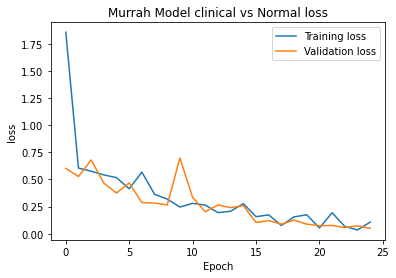

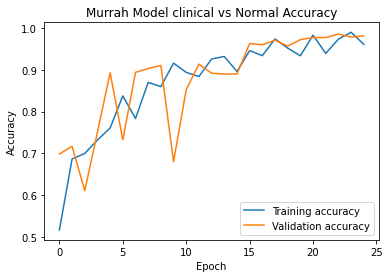

In [46]:
# loss
plt.plot(model_fit.history['loss'], label='Training loss')
plt.plot(model_fit.history['val_loss'], label='Validation loss')
plt.title('Murrah Model clinical vs Normal loss')
plt.ylabel('loss')
plt.xlabel('Epoch')
plt.legend()
plt.show() 

# accuracies

plt.plot(model_fit.history['accuracy'])
plt.plot(model_fit.history['val_accuracy'])
plt.title('Murrah Model clinical vs Normal Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Training accuracy', 'Validation accuracy'], loc='lower right')
# plt.savefig('Sequential_clinical_accuracies')
# plt.savefig('Sequentia_clinical_LossVal_loss')



In [17]:
# dir_path = r'D:\\ANURAG GUPTA\\Clinical vs normal\\test'
# label=[]
# pred=[]
# b=1
# for jj in os.listdir(dir_path):
#     if (jj=="clinical"):
#         b=0
    

#     for i in os.listdir(dir_path+"/"+jj):
#         img = image.load_img(dir_path+"/"+jj+"/" + i, target_size=(200,200))
#         plt.imshow(img)
#         plt.show()

#         X= image.img_to_array(img)
#         X= np.expand_dims(X,axis=0)
#         images=np.vstack([X])
#         label.append(b)
        
#         val = model.predict(images)
#         pred.append(val)
#         if val == 0:
#             print("Clinical" +str(val))
#         elif val==1:
#             print("Normal"+str(val))
#         else:
#             print(val)


In [38]:
saved_model="Murrah_mastitis_model_clinical_vs_Normal.h5"
model.save(saved_model)

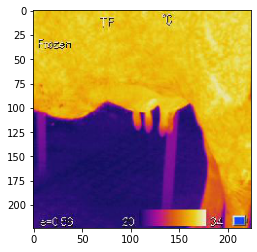

1/1 [==============================] - 0s 109ms/step
Clinical


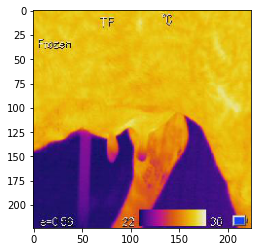

1/1 [==============================] - 0s 16ms/step
Clinical


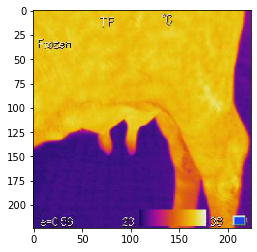

1/1 [==============================] - 0s 31ms/step
Clinical


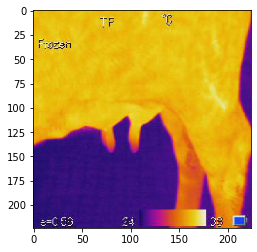

1/1 [==============================] - 0s 31ms/step
Clinical


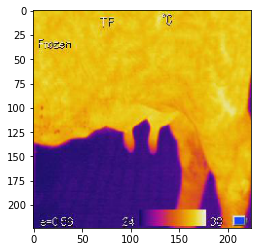

1/1 [==============================] - 0s 16ms/step
Clinical


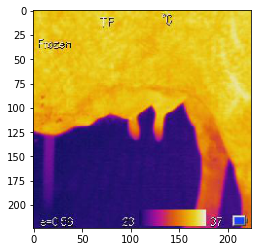

1/1 [==============================] - 0s 31ms/step
Clinical


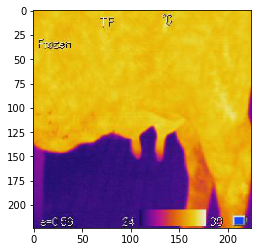

1/1 [==============================] - 0s 31ms/step
Clinical


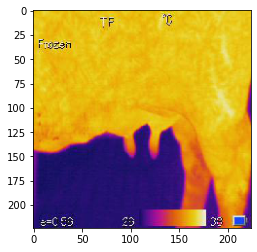

1/1 [==============================] - 0s 31ms/step
Clinical


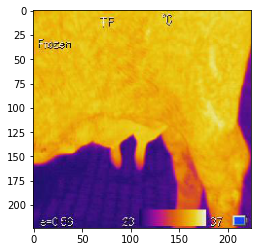

1/1 [==============================] - 0s 16ms/step
Clinical


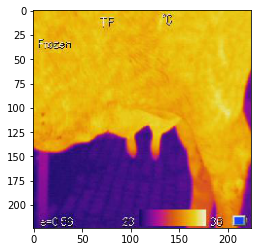

1/1 [==============================] - 0s 31ms/step
Clinical


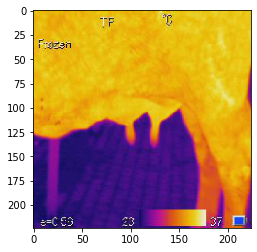

1/1 [==============================] - 0s 24ms/step
Clinical


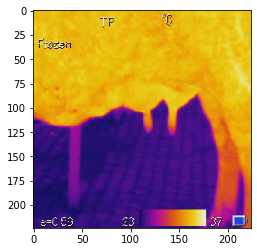

1/1 [==============================] - 0s 31ms/step
Clinical


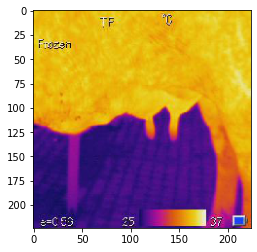

1/1 [==============================] - 0s 29ms/step
Clinical


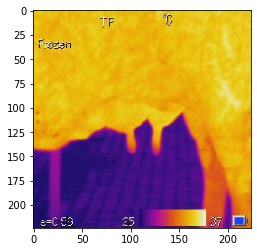

1/1 [==============================] - 0s 16ms/step
Clinical


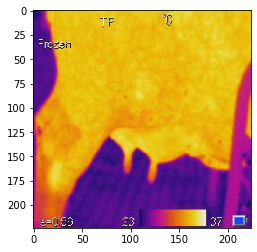

1/1 [==============================] - 0s 16ms/step
Clinical


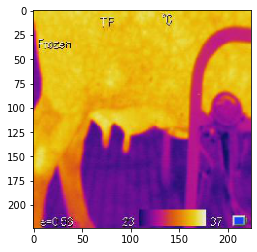

1/1 [==============================] - 0s 31ms/step
Clinical


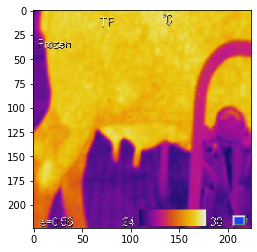

1/1 [==============================] - 0s 16ms/step
Clinical


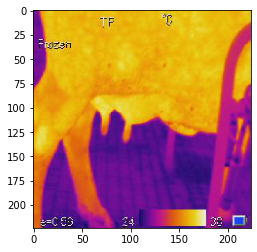

1/1 [==============================] - 0s 16ms/step
Normal


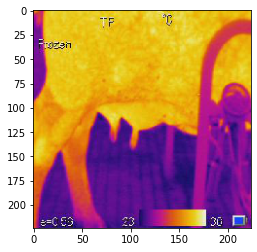

1/1 [==============================] - 0s 16ms/step
Clinical


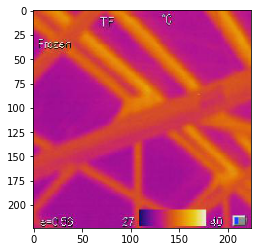

1/1 [==============================] - 0s 16ms/step
Clinical


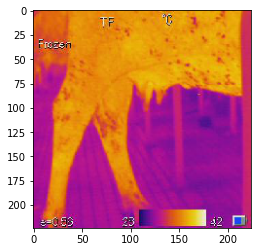

1/1 [==============================] - 0s 31ms/step
[[0.34100726]]


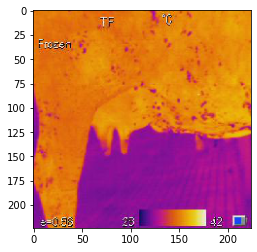

1/1 [==============================] - 0s 31ms/step
Clinical


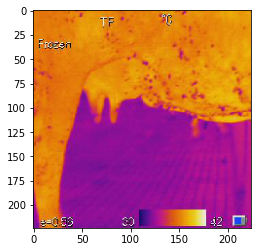

1/1 [==============================] - 0s 31ms/step
Clinical


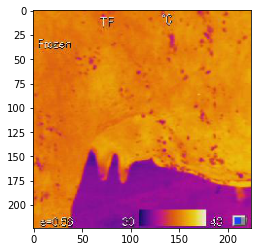

1/1 [==============================] - 0s 17ms/step
Clinical


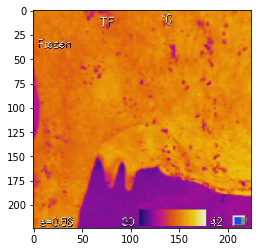

1/1 [==============================] - 0s 31ms/step
Clinical


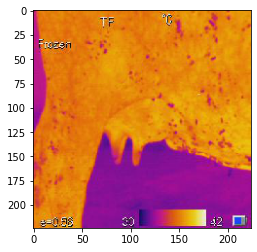

1/1 [==============================] - 0s 16ms/step
Clinical


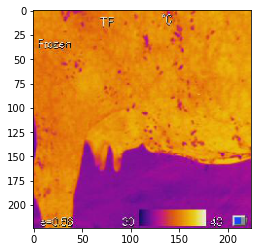

1/1 [==============================] - 0s 31ms/step
Clinical


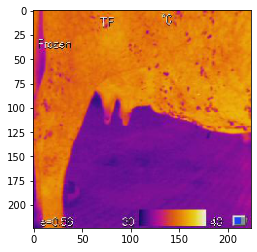

1/1 [==============================] - 0s 31ms/step
Clinical


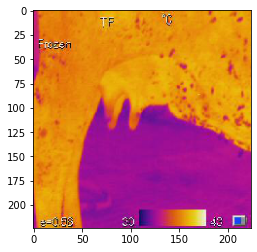

1/1 [==============================] - 0s 16ms/step
Clinical


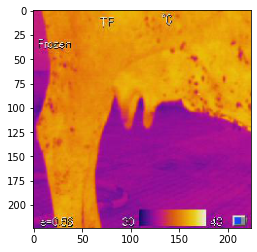

1/1 [==============================] - 0s 31ms/step
Clinical


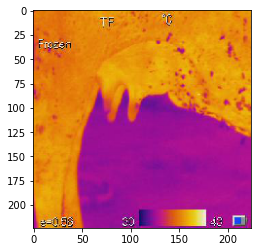

1/1 [==============================] - 0s 16ms/step
Clinical


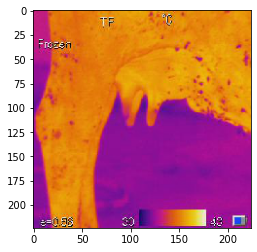

1/1 [==============================] - 0s 31ms/step
Clinical


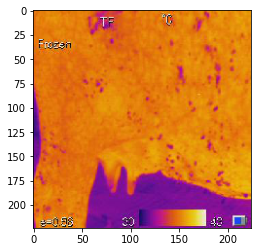

1/1 [==============================] - 0s 16ms/step
Clinical


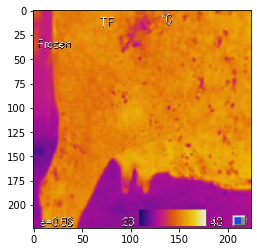

1/1 [==============================] - 0s 31ms/step
Clinical


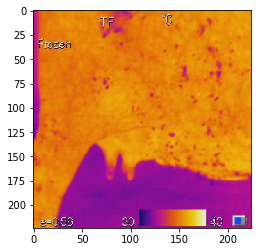

1/1 [==============================] - 0s 31ms/step
Clinical


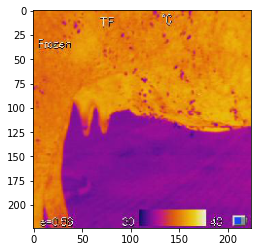

1/1 [==============================] - 0s 31ms/step
Clinical


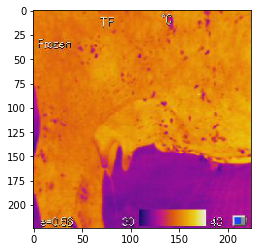

1/1 [==============================] - 0s 16ms/step
Clinical


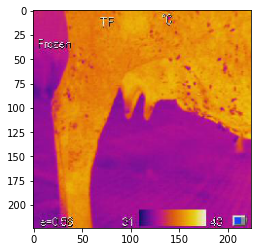

1/1 [==============================] - 0s 31ms/step
Clinical


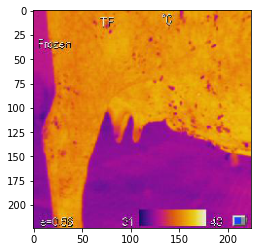

1/1 [==============================] - 0s 31ms/step
Clinical


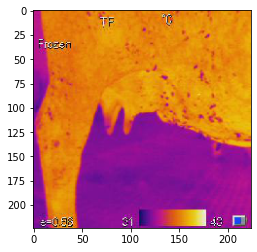

1/1 [==============================] - 0s 31ms/step
Clinical


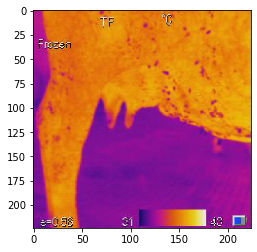

1/1 [==============================] - 0s 16ms/step
Clinical


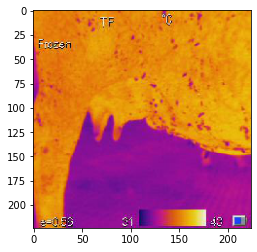

1/1 [==============================] - 0s 16ms/step
Clinical


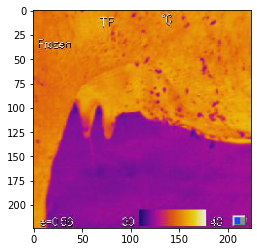

1/1 [==============================] - 0s 31ms/step
Clinical


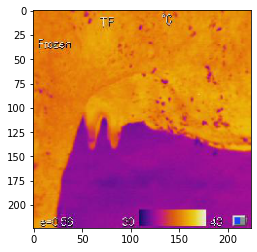

1/1 [==============================] - 0s 31ms/step
Clinical


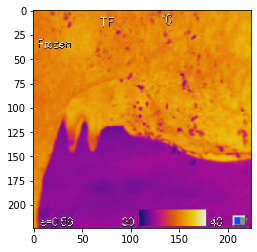

1/1 [==============================] - 0s 31ms/step
Clinical


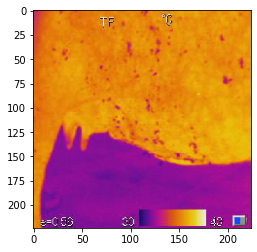

1/1 [==============================] - 0s 31ms/step
Clinical


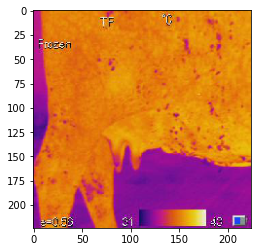

1/1 [==============================] - 0s 16ms/step
Clinical


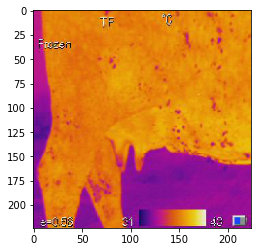

1/1 [==============================] - 0s 31ms/step
Clinical


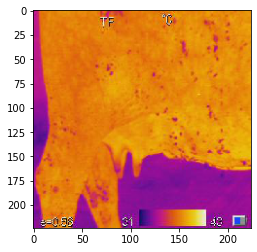

1/1 [==============================] - 0s 31ms/step
Clinical


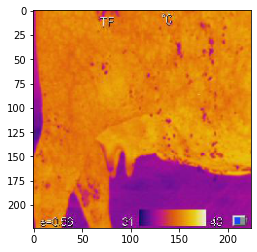

1/1 [==============================] - 0s 16ms/step
Clinical


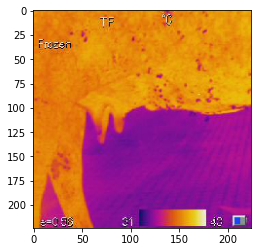

1/1 [==============================] - 0s 31ms/step
Clinical


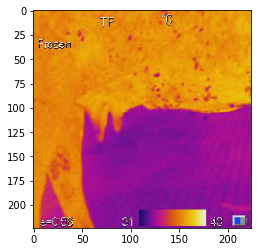

1/1 [==============================] - 0s 16ms/step
Clinical


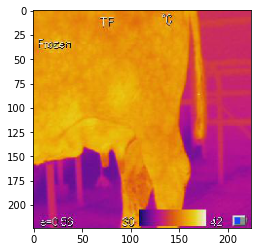

1/1 [==============================] - 0s 15ms/step
Clinical


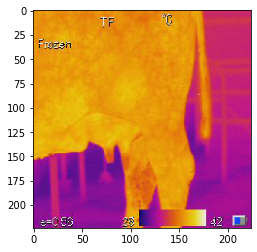

1/1 [==============================] - 0s 31ms/step
Clinical


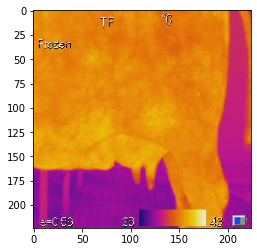

1/1 [==============================] - 0s 16ms/step
Clinical


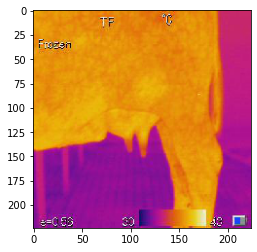

1/1 [==============================] - 0s 16ms/step
Clinical


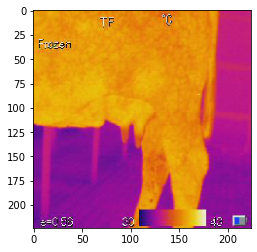

1/1 [==============================] - 0s 31ms/step
Clinical


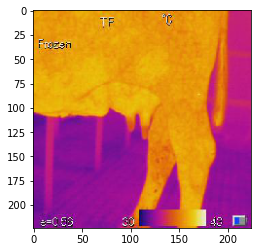

1/1 [==============================] - 0s 31ms/step
Clinical


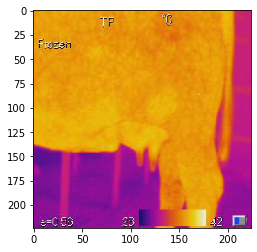

1/1 [==============================] - 0s 16ms/step
Clinical


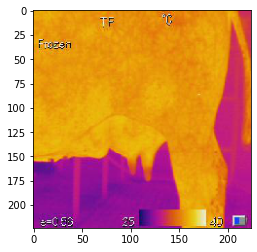

1/1 [==============================] - 0s 16ms/step
Clinical


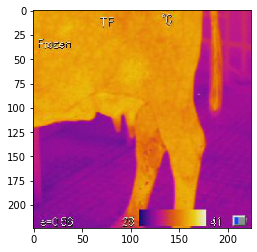

1/1 [==============================] - 0s 31ms/step
Clinical


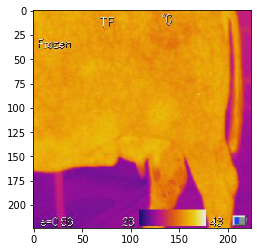

1/1 [==============================] - 0s 16ms/step
Clinical


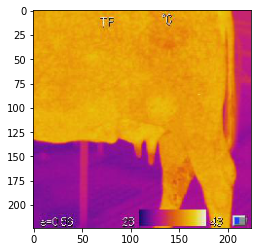

1/1 [==============================] - 0s 31ms/step
Clinical


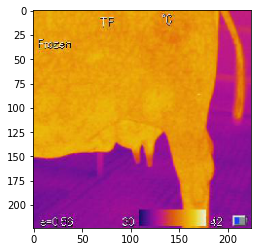

1/1 [==============================] - 0s 16ms/step
Clinical


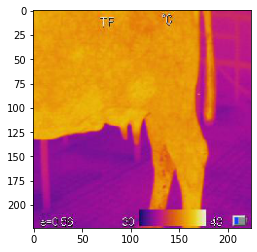

1/1 [==============================] - 0s 31ms/step
Clinical


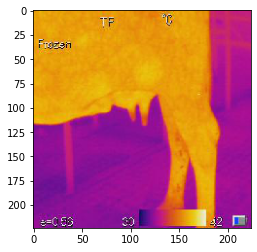

1/1 [==============================] - 0s 31ms/step
Clinical


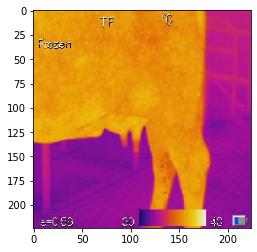

1/1 [==============================] - 0s 31ms/step
Clinical


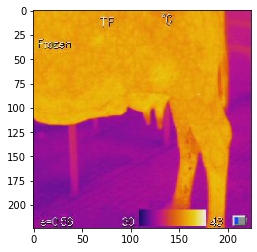

1/1 [==============================] - 0s 16ms/step
Clinical


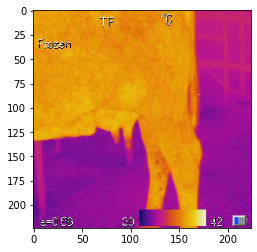

1/1 [==============================] - 0s 31ms/step
Clinical


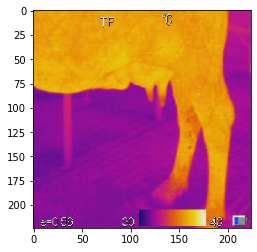

1/1 [==============================] - 0s 31ms/step
Clinical


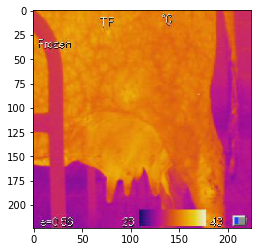

1/1 [==============================] - 0s 16ms/step
Normal


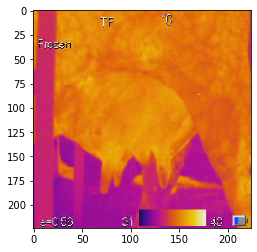

1/1 [==============================] - 0s 31ms/step
Normal


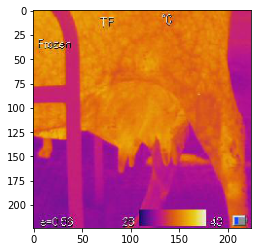

1/1 [==============================] - 0s 16ms/step
Normal


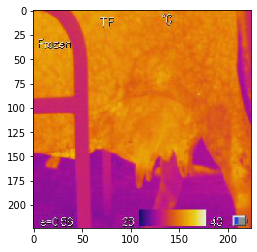

1/1 [==============================] - 0s 31ms/step
Normal


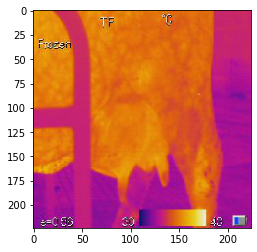

1/1 [==============================] - 0s 31ms/step
Clinical


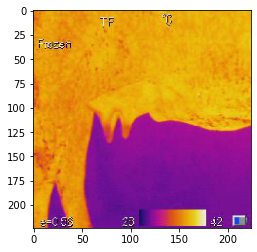

1/1 [==============================] - 0s 16ms/step
Clinical


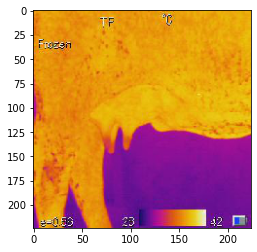

1/1 [==============================] - 0s 31ms/step
Clinical


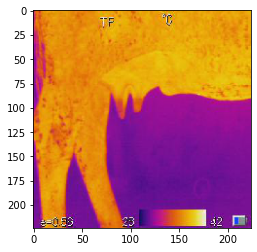

1/1 [==============================] - 0s 31ms/step
Clinical


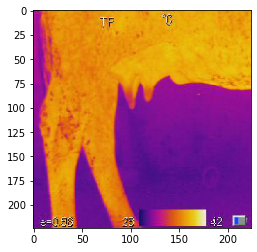

1/1 [==============================] - 0s 31ms/step
Clinical


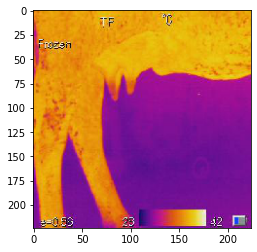

1/1 [==============================] - 0s 16ms/step
Normal


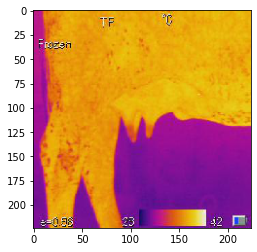

1/1 [==============================] - 0s 31ms/step
Clinical


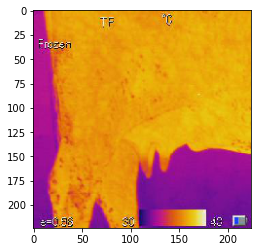

1/1 [==============================] - 0s 31ms/step
Clinical


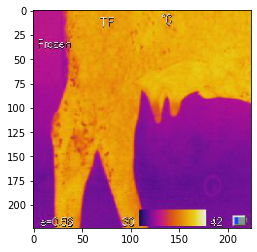

1/1 [==============================] - 0s 31ms/step
Clinical


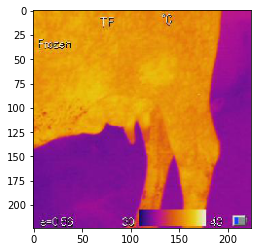

1/1 [==============================] - 0s 16ms/step
Clinical


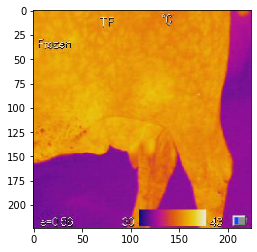

1/1 [==============================] - 0s 16ms/step
Clinical


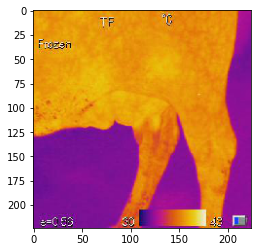

1/1 [==============================] - 0s 16ms/step
Clinical


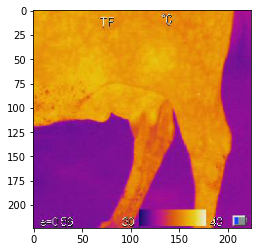

1/1 [==============================] - 0s 16ms/step
Clinical


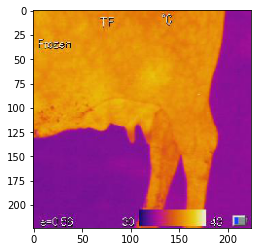

1/1 [==============================] - 0s 16ms/step
Clinical


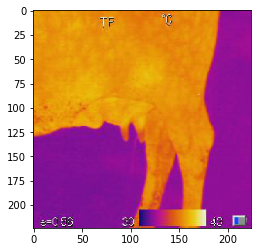

1/1 [==============================] - 0s 31ms/step
Clinical


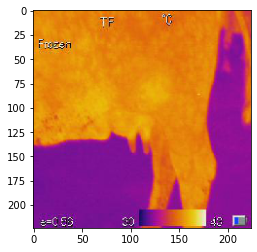

1/1 [==============================] - 0s 31ms/step
Clinical


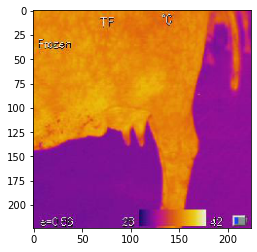

1/1 [==============================] - 0s 31ms/step
Clinical


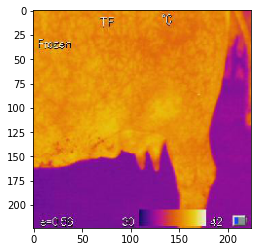

1/1 [==============================] - 0s 16ms/step
Clinical


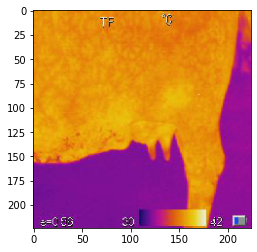

1/1 [==============================] - 0s 16ms/step
Clinical


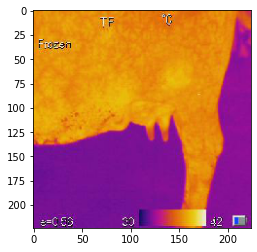

1/1 [==============================] - 0s 16ms/step
Clinical


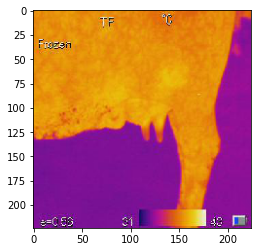

1/1 [==============================] - 0s 31ms/step
Clinical


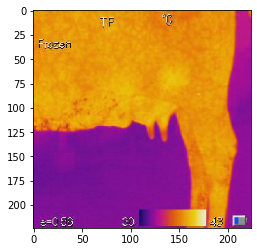

1/1 [==============================] - 0s 31ms/step
Clinical


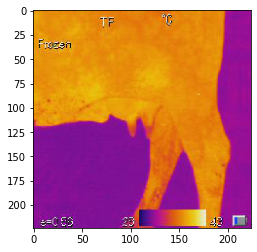

1/1 [==============================] - 0s 31ms/step
Clinical


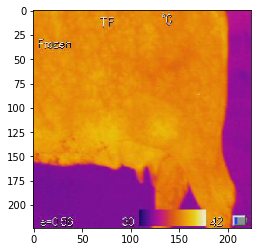

1/1 [==============================] - 0s 31ms/step
[[0.00767247]]


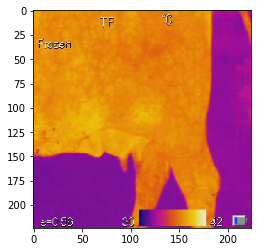

1/1 [==============================] - 0s 31ms/step
Clinical


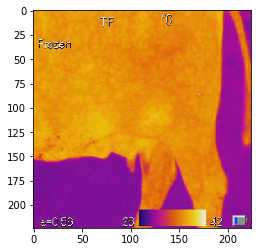

1/1 [==============================] - 0s 16ms/step
Normal


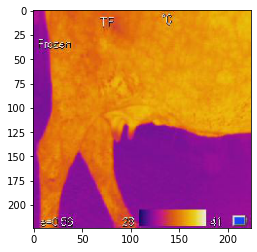

1/1 [==============================] - 0s 16ms/step
Clinical


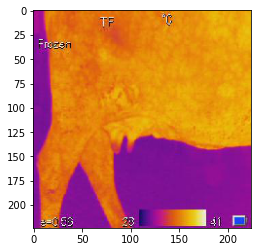

1/1 [==============================] - 0s 31ms/step
Clinical


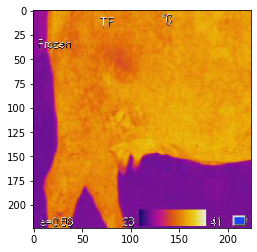

1/1 [==============================] - 0s 31ms/step
Clinical


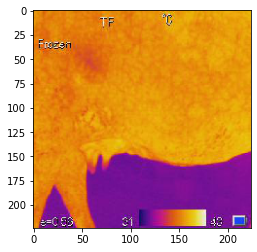

1/1 [==============================] - 0s 16ms/step
Clinical


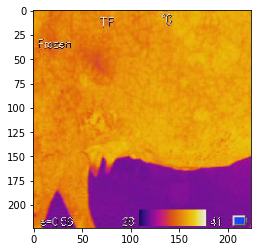

1/1 [==============================] - 0s 31ms/step
Clinical


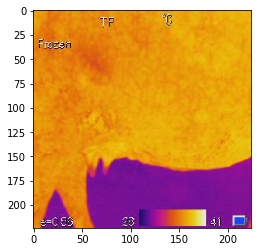

1/1 [==============================] - 0s 31ms/step
Clinical


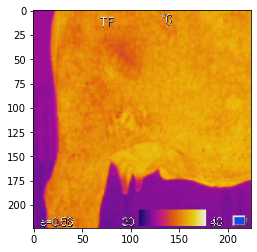

1/1 [==============================] - 0s 31ms/step
Clinical


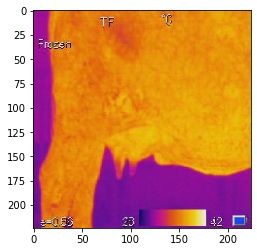

1/1 [==============================] - 0s 16ms/step
Clinical


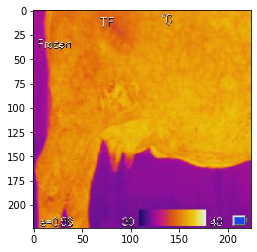

1/1 [==============================] - 0s 16ms/step
Clinical


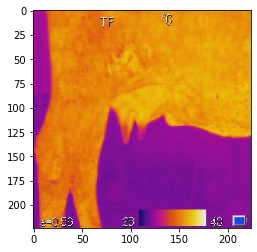

1/1 [==============================] - 0s 16ms/step
Clinical


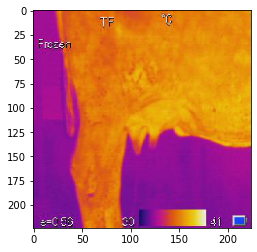

1/1 [==============================] - 0s 31ms/step
Clinical


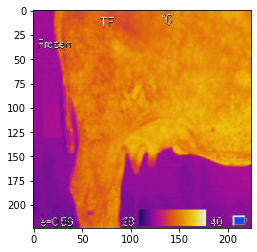

1/1 [==============================] - 0s 31ms/step
Clinical


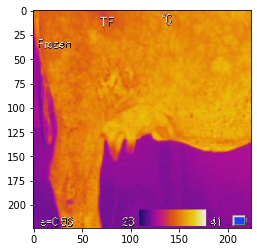

1/1 [==============================] - 0s 31ms/step
Clinical


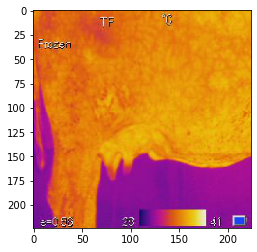

1/1 [==============================] - 0s 31ms/step
Clinical


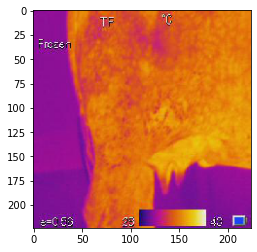

1/1 [==============================] - 0s 16ms/step
Clinical


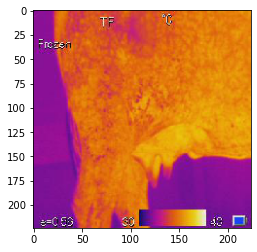

1/1 [==============================] - 0s 16ms/step
Clinical


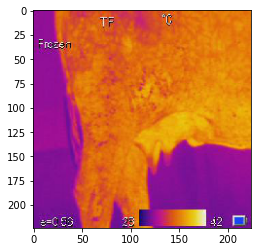

1/1 [==============================] - 0s 31ms/step
Clinical


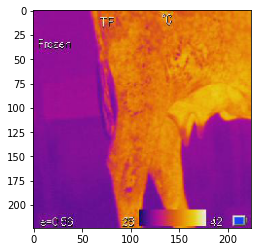

1/1 [==============================] - 0s 16ms/step
Clinical


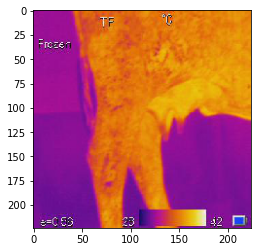

1/1 [==============================] - 0s 16ms/step
Clinical


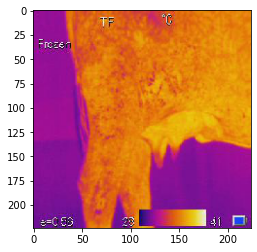

1/1 [==============================] - 0s 31ms/step
Clinical


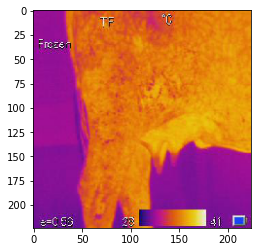

1/1 [==============================] - 0s 31ms/step
Clinical


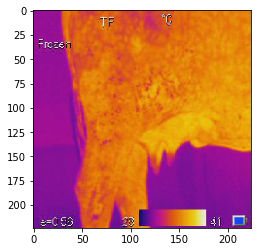

1/1 [==============================] - 0s 31ms/step
Clinical


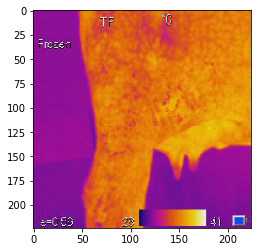

1/1 [==============================] - 0s 31ms/step
Clinical


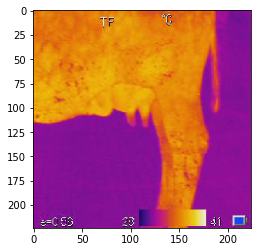

1/1 [==============================] - 0s 16ms/step
Clinical


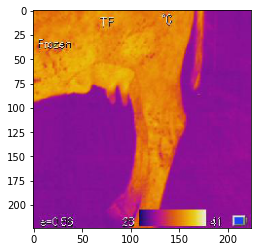

1/1 [==============================] - 0s 16ms/step
Clinical


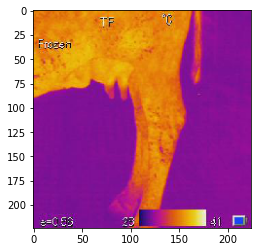

1/1 [==============================] - 0s 31ms/step
Clinical


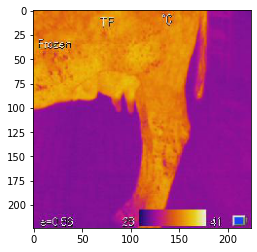

1/1 [==============================] - 0s 32ms/step
Clinical


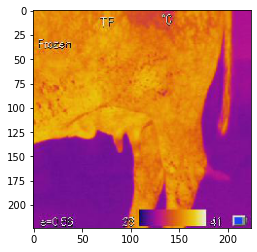

1/1 [==============================] - 0s 31ms/step
Clinical


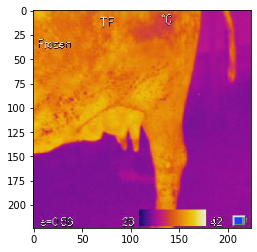

1/1 [==============================] - 0s 16ms/step
Clinical


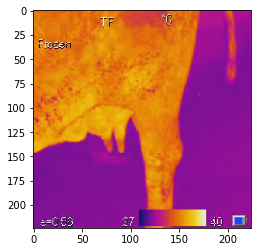

1/1 [==============================] - 0s 16ms/step
Clinical


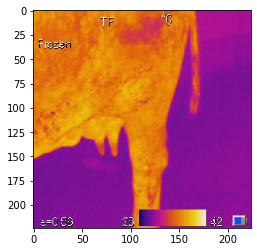

1/1 [==============================] - 0s 31ms/step
Clinical


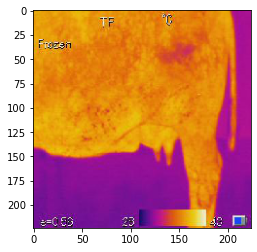

1/1 [==============================] - 0s 31ms/step
Clinical


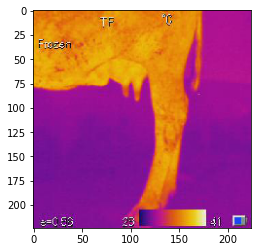

1/1 [==============================] - 0s 16ms/step
Clinical


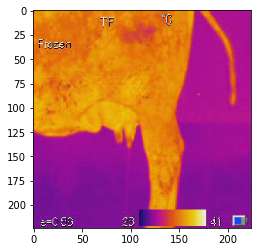

1/1 [==============================] - 0s 16ms/step
Clinical


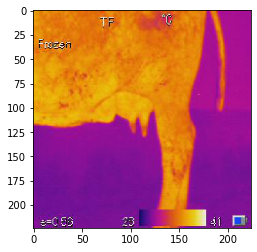

1/1 [==============================] - 0s 16ms/step
Clinical


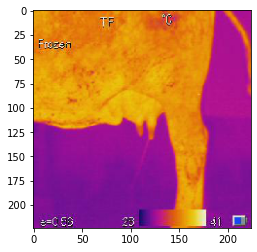

1/1 [==============================] - 0s 31ms/step
Clinical


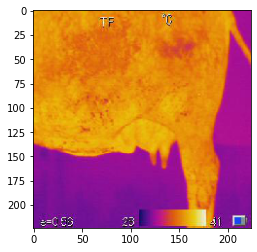

1/1 [==============================] - 0s 31ms/step
Clinical


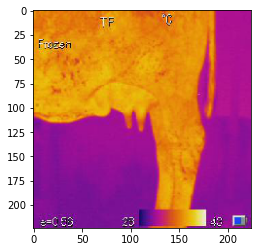

1/1 [==============================] - 0s 32ms/step
Clinical


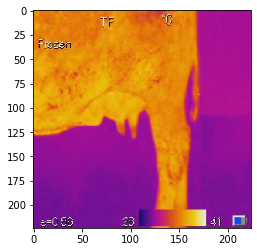

1/1 [==============================] - 0s 16ms/step
Clinical


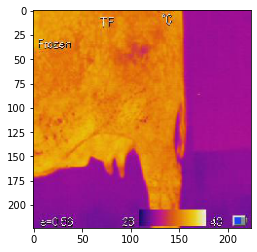

1/1 [==============================] - 0s 31ms/step
Clinical


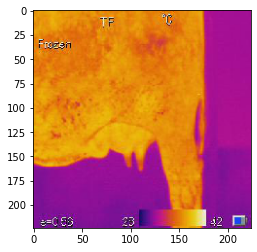

1/1 [==============================] - 0s 31ms/step
Clinical


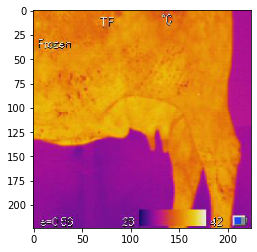

1/1 [==============================] - 0s 31ms/step
Clinical


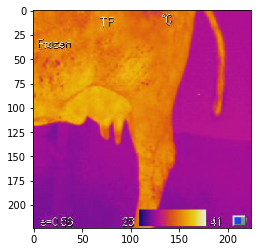

1/1 [==============================] - 0s 31ms/step
Clinical


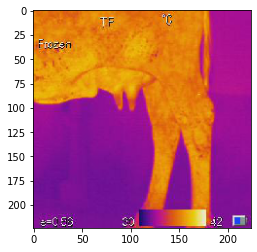

1/1 [==============================] - 0s 16ms/step
Clinical


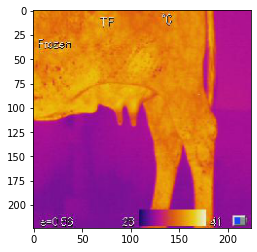

1/1 [==============================] - 0s 31ms/step
Clinical


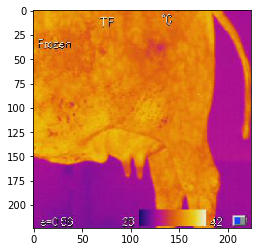

1/1 [==============================] - 0s 16ms/step
Clinical


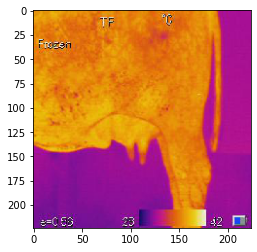

1/1 [==============================] - 0s 16ms/step
Clinical


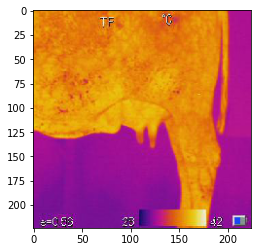

1/1 [==============================] - 0s 31ms/step
Clinical


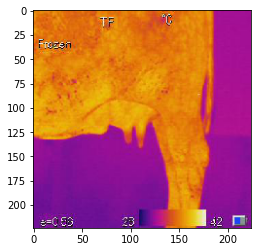

1/1 [==============================] - 0s 16ms/step
Clinical


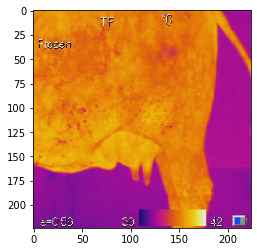

1/1 [==============================] - 0s 31ms/step
Clinical


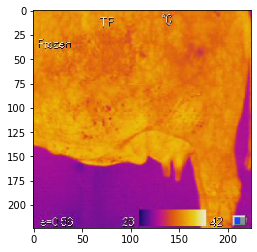

1/1 [==============================] - 0s 31ms/step
Clinical


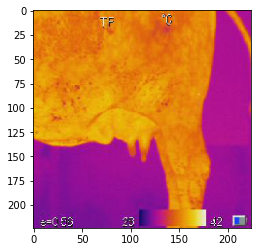

1/1 [==============================] - 0s 16ms/step
Clinical


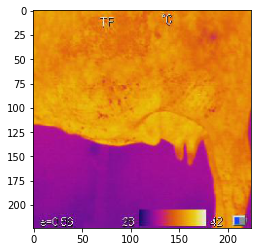

1/1 [==============================] - 0s 31ms/step
Clinical


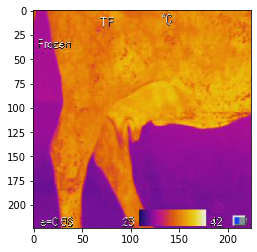

1/1 [==============================] - 0s 31ms/step
Clinical


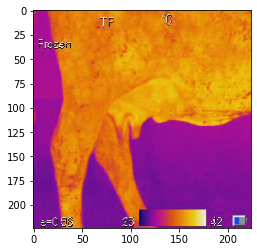

1/1 [==============================] - 0s 31ms/step
Clinical


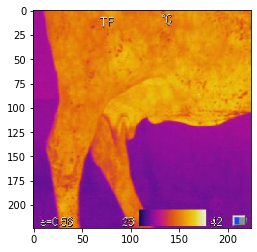

1/1 [==============================] - 0s 31ms/step
Clinical


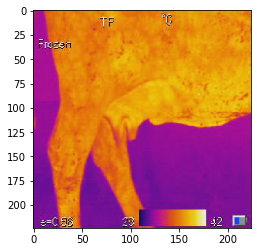

1/1 [==============================] - 0s 31ms/step
Clinical


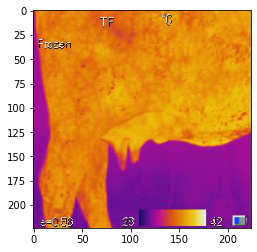

1/1 [==============================] - 0s 31ms/step
Clinical


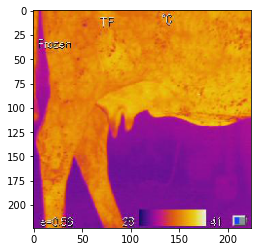

1/1 [==============================] - 0s 31ms/step
Clinical


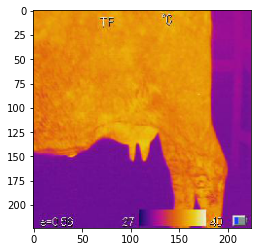

1/1 [==============================] - 0s 16ms/step
Normal


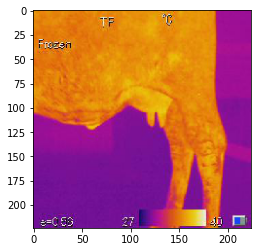

1/1 [==============================] - 0s 16ms/step
Clinical


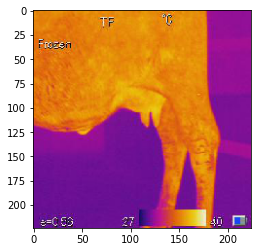

1/1 [==============================] - 0s 16ms/step
Clinical


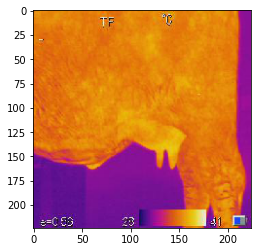

1/1 [==============================] - 0s 31ms/step
Clinical


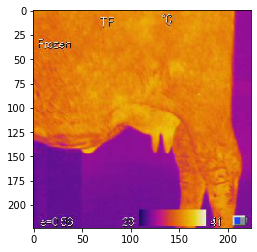

1/1 [==============================] - 0s 31ms/step
Clinical


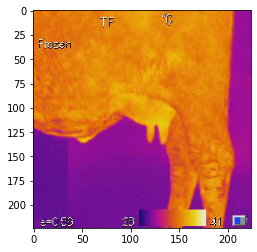

1/1 [==============================] - 0s 31ms/step
Clinical


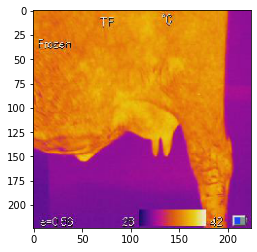

1/1 [==============================] - 0s 31ms/step
Clinical


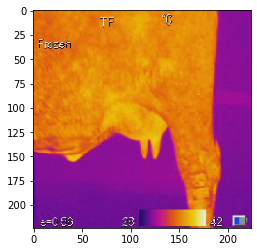

1/1 [==============================] - 0s 16ms/step
Clinical


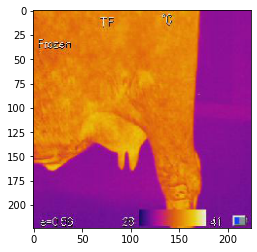

1/1 [==============================] - 0s 16ms/step
Clinical


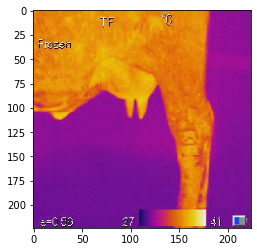

1/1 [==============================] - 0s 31ms/step
Clinical


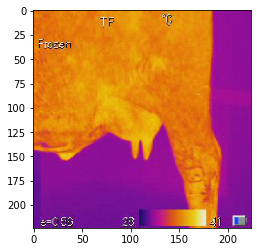

1/1 [==============================] - 0s 31ms/step
Clinical


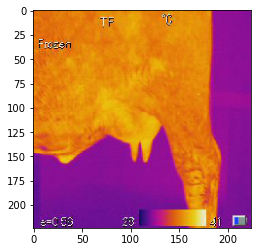

1/1 [==============================] - 0s 31ms/step
Clinical


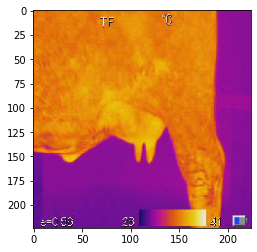

1/1 [==============================] - 0s 31ms/step
Clinical


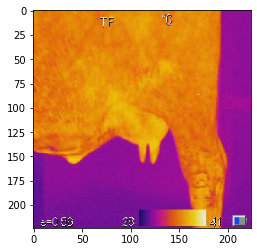

1/1 [==============================] - 0s 16ms/step
Clinical


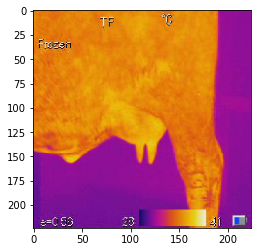

1/1 [==============================] - 0s 16ms/step
Clinical


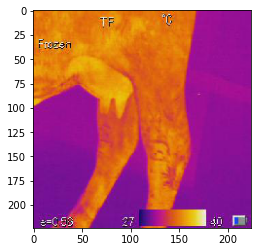

1/1 [==============================] - 0s 31ms/step
Clinical


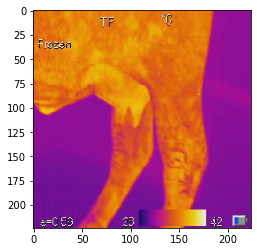

1/1 [==============================] - 0s 31ms/step
Clinical


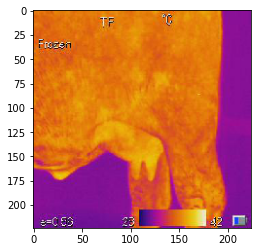

1/1 [==============================] - 0s 31ms/step
Clinical


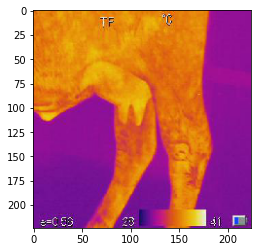

1/1 [==============================] - 0s 16ms/step
Clinical


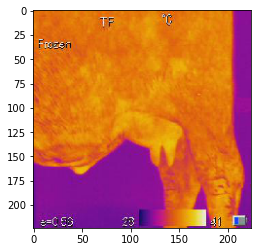

1/1 [==============================] - 0s 31ms/step
Clinical


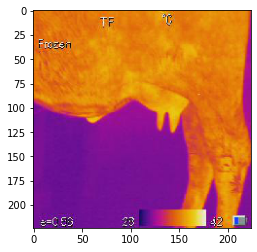

1/1 [==============================] - 0s 31ms/step
Clinical


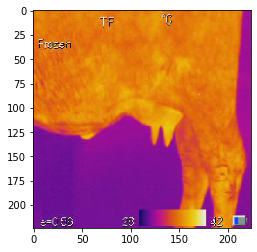

1/1 [==============================] - 0s 16ms/step
Clinical


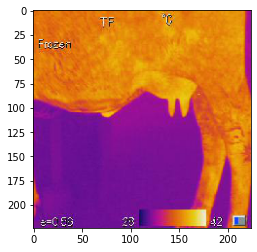

1/1 [==============================] - 0s 31ms/step
Clinical


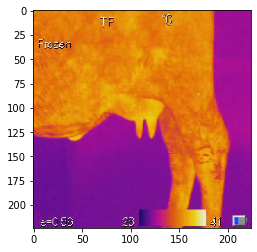

1/1 [==============================] - 0s 16ms/step
Clinical


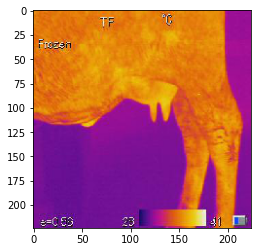

1/1 [==============================] - 0s 31ms/step
Clinical


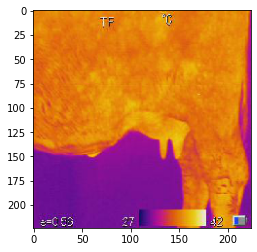

1/1 [==============================] - 0s 31ms/step
Clinical


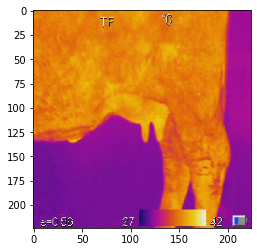

1/1 [==============================] - 0s 31ms/step
Clinical


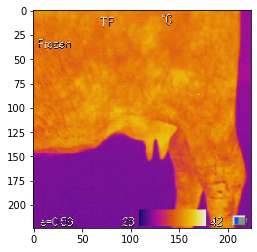

1/1 [==============================] - 0s 31ms/step
Clinical


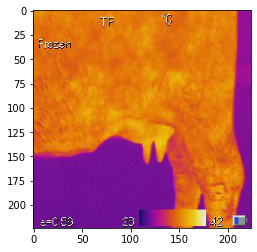

1/1 [==============================] - 0s 31ms/step
Clinical


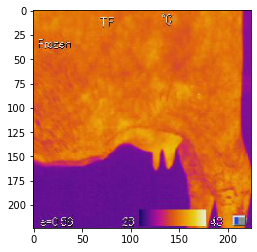

1/1 [==============================] - 0s 16ms/step
Clinical


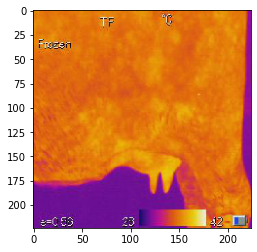

1/1 [==============================] - 0s 31ms/step
Clinical


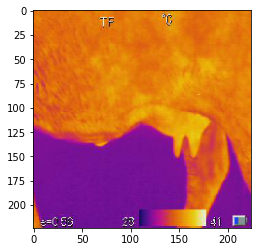

1/1 [==============================] - 0s 16ms/step
Clinical


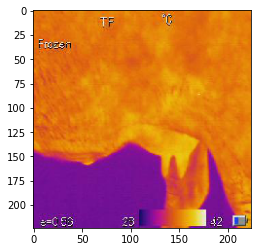

1/1 [==============================] - 0s 16ms/step
Clinical


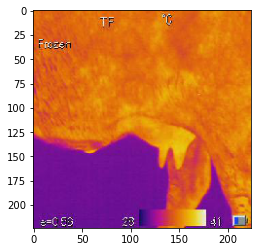

1/1 [==============================] - 0s 31ms/step
Clinical


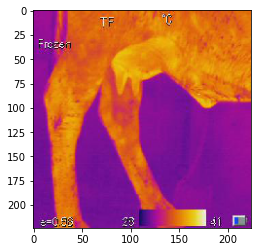

1/1 [==============================] - 0s 31ms/step
Clinical


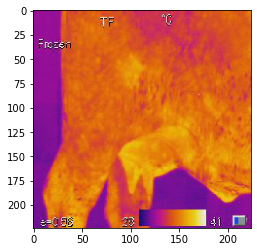

1/1 [==============================] - 0s 31ms/step
Clinical


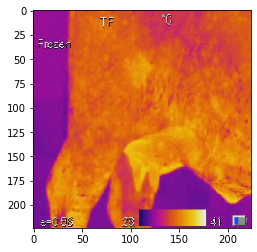

1/1 [==============================] - 0s 31ms/step
Clinical


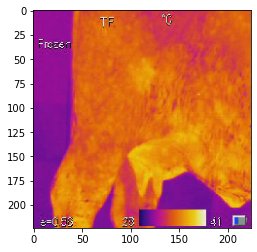

1/1 [==============================] - 0s 16ms/step
Clinical


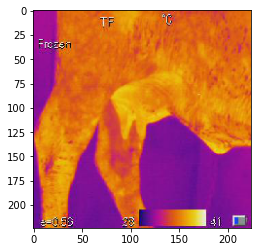

1/1 [==============================] - 0s 31ms/step
Clinical


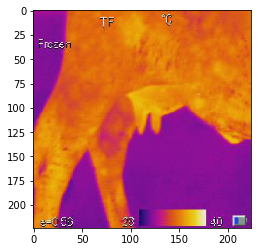

1/1 [==============================] - 0s 16ms/step
Clinical


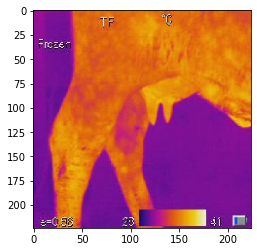

1/1 [==============================] - 0s 16ms/step
Clinical


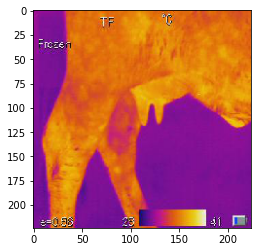

1/1 [==============================] - 0s 16ms/step
Clinical


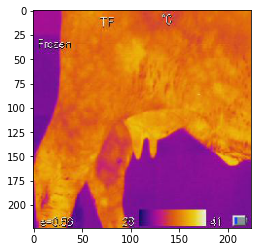

1/1 [==============================] - 0s 31ms/step
Clinical


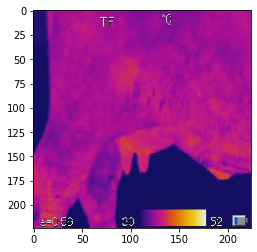

1/1 [==============================] - 0s 16ms/step
Clinical


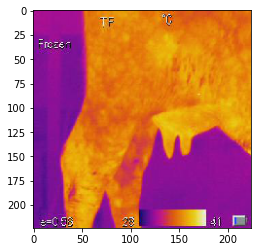

1/1 [==============================] - 0s 30ms/step
Clinical


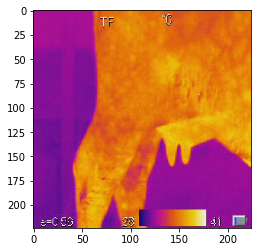

1/1 [==============================] - 0s 31ms/step
Clinical


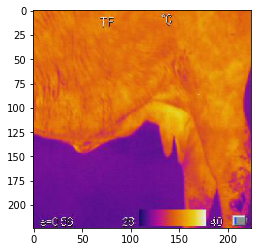

1/1 [==============================] - 0s 16ms/step
Clinical


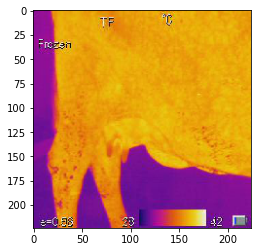

1/1 [==============================] - 0s 16ms/step
Clinical


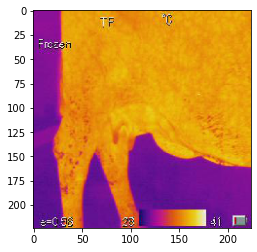

1/1 [==============================] - 0s 31ms/step
Clinical


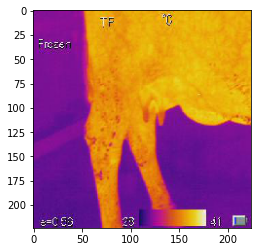

1/1 [==============================] - 0s 31ms/step
Clinical


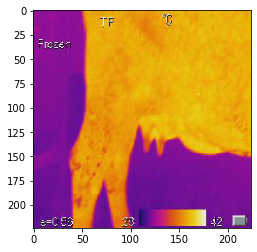

1/1 [==============================] - 0s 16ms/step
Clinical


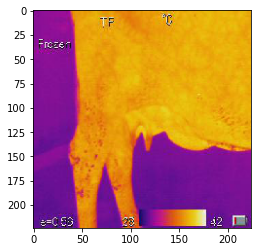

1/1 [==============================] - 0s 16ms/step
Clinical


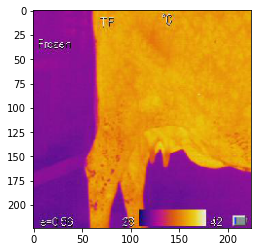

1/1 [==============================] - 0s 32ms/step
Clinical


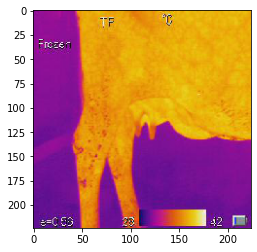

1/1 [==============================] - 0s 31ms/step
Clinical


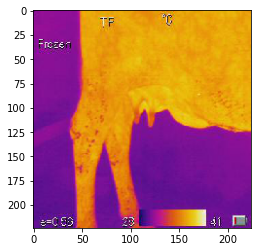

1/1 [==============================] - 0s 16ms/step
Clinical


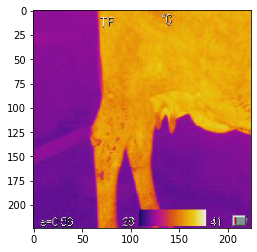

1/1 [==============================] - 0s 16ms/step
Clinical


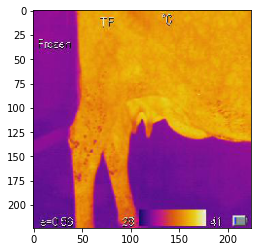

1/1 [==============================] - 0s 31ms/step
Clinical


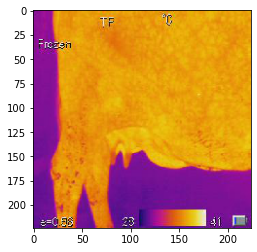

1/1 [==============================] - 0s 16ms/step
Normal


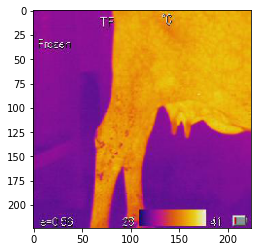

1/1 [==============================] - 0s 31ms/step
Clinical


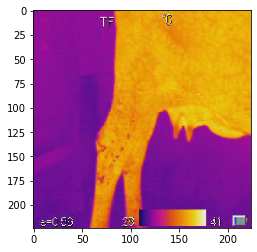

1/1 [==============================] - 0s 16ms/step
Clinical


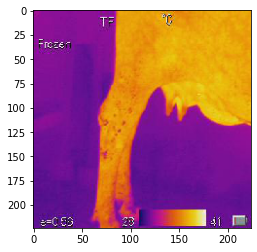

1/1 [==============================] - 0s 16ms/step
Clinical


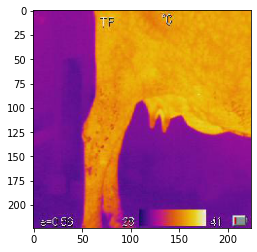

1/1 [==============================] - 0s 31ms/step
Clinical


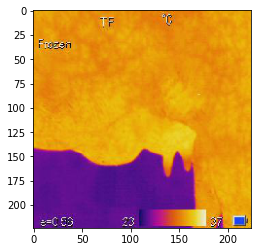

1/1 [==============================] - 0s 16ms/step
Clinical


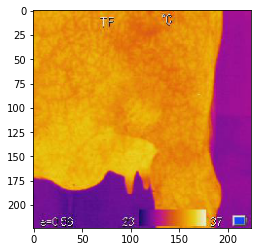

1/1 [==============================] - 0s 31ms/step
Clinical


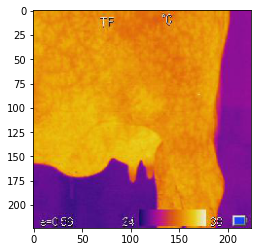

1/1 [==============================] - 0s 16ms/step
Clinical


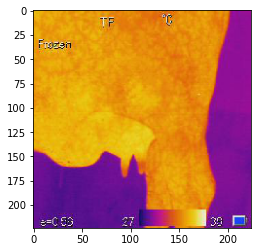

1/1 [==============================] - 0s 16ms/step
Clinical


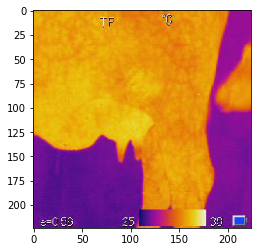

1/1 [==============================] - 0s 31ms/step
Normal


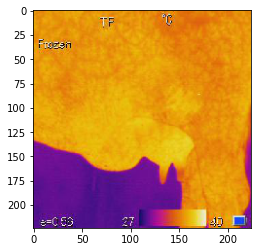

1/1 [==============================] - 0s 31ms/step
Clinical


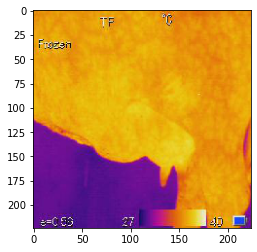

1/1 [==============================] - 0s 31ms/step
Normal


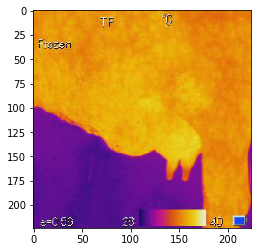

1/1 [==============================] - 0s 16ms/step
Normal


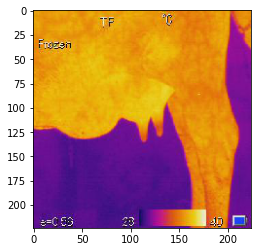

1/1 [==============================] - 0s 16ms/step
Clinical


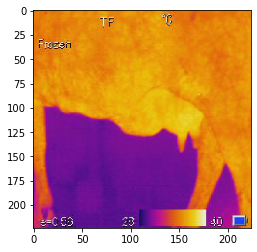

1/1 [==============================] - 0s 23ms/step
Clinical


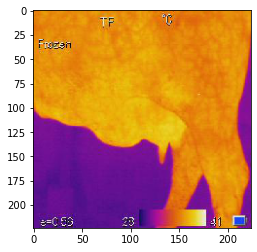

1/1 [==============================] - 0s 31ms/step
Clinical


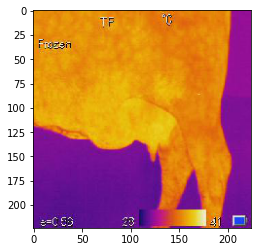

1/1 [==============================] - 0s 31ms/step
Clinical


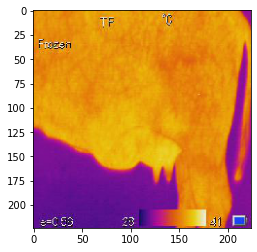

1/1 [==============================] - 0s 31ms/step
Normal


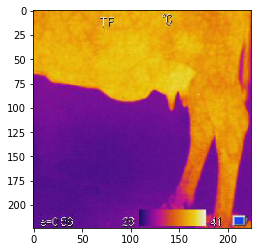

1/1 [==============================] - 0s 31ms/step
Clinical


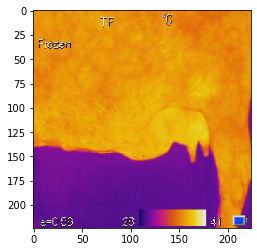

1/1 [==============================] - 0s 16ms/step
Clinical


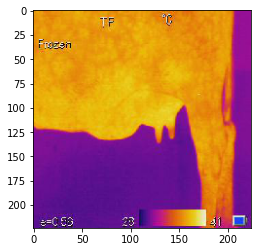

1/1 [==============================] - 0s 31ms/step
Clinical


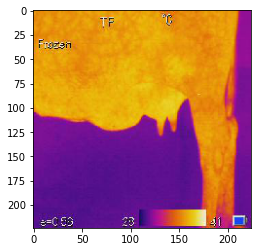

1/1 [==============================] - 0s 16ms/step
Clinical


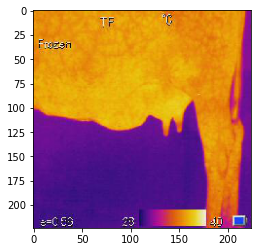

1/1 [==============================] - 0s 31ms/step
Clinical


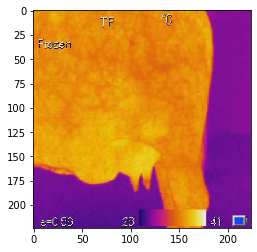

1/1 [==============================] - 0s 16ms/step
Clinical


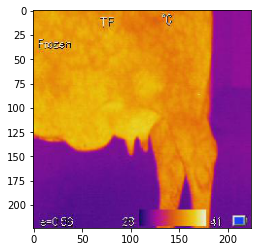

1/1 [==============================] - 0s 16ms/step
Clinical


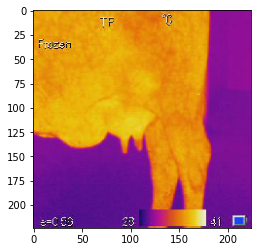

1/1 [==============================] - 0s 31ms/step
Clinical


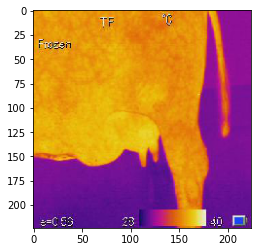

1/1 [==============================] - 0s 16ms/step
Clinical


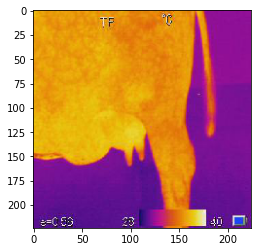

1/1 [==============================] - 0s 40ms/step
Clinical


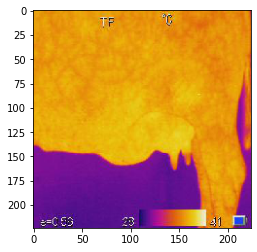

1/1 [==============================] - 0s 16ms/step
Clinical


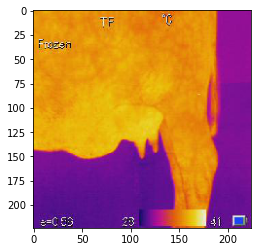

1/1 [==============================] - 0s 16ms/step
Clinical


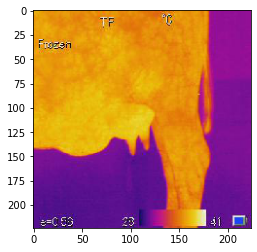

1/1 [==============================] - 0s 16ms/step
Clinical


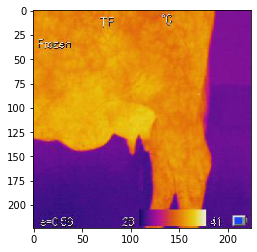

1/1 [==============================] - 0s 31ms/step
Clinical


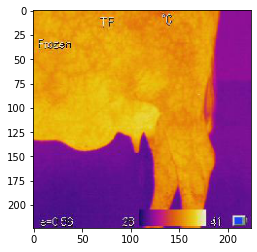

1/1 [==============================] - 0s 31ms/step
Clinical


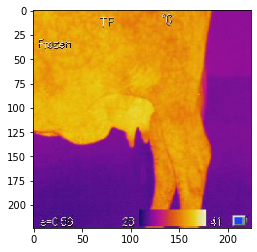

1/1 [==============================] - 0s 31ms/step
Clinical


In [19]:
dir_path = r'D:\ANURAG GUPTA\MastitisDataForMurrah\Clinical_Normal_Murrah\test\clinical mastitis'

for i in os.listdir(dir_path ):
    img = image.load_img(dir_path + "//" + i, target_size=(224,224))
    plt.imshow(img)
    plt.show()
    
    X= image.img_to_array(img)
    X= np.expand_dims(X,axis=0)
    images=np.vstack([X])
    
    val = model.predict(images)
    if val == 0:
        print("Clinical")
    elif val==1:
        print("Normal")
    else:
        print(val)
    

In [20]:
from tensorflow import keras
from keras.models import Model


In [39]:
model = keras.models.load_model("Murrah_mastitis_model_clinical_vs_Normal.h5")

In [40]:
test_path = r"D:\ANURAG GUPTA\MastitisDataForMurrah\Clinical_Normal_Murrah\test"

test_datagen = ImageDataGenerator(rescale=1./255)

test_generator = test_datagen.flow_from_directory(test_path, 
                                                    target_size=(224, 224), 
                                               
                                                    class_mode="binary")

Found 488 images belonging to 2 classes.


In [41]:
os.listdir(test_path)

['clinical mastitis', 'healthy']

In [42]:
dir_path1 = r'D:\ANURAG GUPTA\MastitisDataForMurrah\Clinical_Normal_Murrah\test\clinical mastitis'
dir_path = r'D:\ANURAG GUPTA\MastitisDataForMurrah\Clinical_Normal_Murrah\test\healthy'

val_array_clinical=[]
val_array_normal=[]

for i in os.listdir(dir_path1 ):
    img = keras.utils.load_img(dir_path1 + "//" + i, target_size=(224,224))
    
    
#     plt.imshow(img)
#     plt.show()
    
    X= keras.utils.img_to_array(img)
    X= np.expand_dims(X,axis=0)
    images=np.vstack([X])
    
    val = model.predict(images)
    if val[0][0] == 0:
        image_val=0
      
    else:
         image_val=1
    
    val_array_clinical.append(image_val)    
    
for i in os.listdir(dir_path ):
    img = keras.utils.load_img(dir_path + "//" + i, target_size=(224,224))
    
    
#     plt.imshow(img)
#     plt.show()
    
    X= keras.utils.img_to_array(img)
    X= np.expand_dims(X,axis=0)
    images=np.vstack([X])
    
    val = model.predict(images)
    if val[0][0] == 0:
        image_val=0
      
    else:
         image_val=1
    
    val_array_normal.append(image_val)    

1/1 [==============================] - 0s 125ms/step


1/1 [==============================] - 0s 62ms/step


1/1 [==============================] - 0s 110ms/step


1/1 [==============================] - 0s 75ms/step


In [43]:
val_array=[]
val_array=val_array_clinical+val_array_normal
print(val_array)

[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 

In [26]:
test_generator.classes

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,

In [27]:
y_pred=val_array

In [28]:
y_true=test_generator.classes

In [29]:
from sklearn.metrics import confusion_matrix
from sklearn import metrics

In [30]:
cm=confusion_matrix(y_true, y_pred)

In [31]:
cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = cm, display_labels = ['Clinical', 'Normal'])

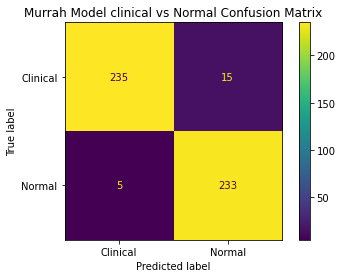

In [52]:
cm_display.plot()
plt.title('Murrah Model clinical vs Normal Confusion Matrix')
plt.show()

In [33]:
Accuracy = metrics.accuracy_score(y_true, y_pred)
Precision = metrics.precision_score(y_true, y_pred)
F1_score = metrics.f1_score(y_true, y_pred)
Specificity = metrics.recall_score(y_true, y_pred, pos_label=0)
Sensitivity_recall = metrics.recall_score(y_true, y_pred)



In [34]:
#All in One
#metrics:
print({"Accuracy":Accuracy,"Precision":Precision,"Sensitivity_recall":Sensitivity_recall,"Specificity":Specificity,"F1_score":F1_score})


{'Accuracy': 0.9590163934426229, 'Precision': 0.9395161290322581, 'Sensitivity_recall': 0.9789915966386554, 'Specificity': 0.94, 'F1_score': 0.9588477366255144}


In [35]:
df={'0': {'Accuracy': Accuracy,
         'precision': Precision,
         'Sensitivity_recall':Sensitivity_recall,
          'Specificity': Specificity,
          'F1_score': F1_score,
  },
}


In [36]:
import pandas as pd
pd.DataFrame(df)

,0
Accuracy,0.959016
F1_score,0.958848
Sensitivity_recall,0.978992
Specificity,0.940000
precision,0.939516
